# Connect your drive to this notebook

In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
import math
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
import matplotlib.pyplot as plt

In [6]:
from google.colab import files

In [5]:
!ls '/content/drive/MyDrive/Colab Notebooks'

ls: cannot access '/content/drive/MyDrive/Colab Notebooks': No such file or directory


In [8]:
import io
gdf = gpd.read_file('/content/drive/MyDrive/Colab Notebooks/2020_Census_Tracts_in_Boston.shp')

In [9]:
census_data = pd.read_csv('https://data.boston.gov/dataset/7846ff3b-b738-47a3-a57e-19de2c753220/resource/013aba13-5985-4067-bba4-a8d3ca9a34ac/download/census-tract-data.csv')
census_data.head()

,FILEID,STUSAB,SUMLEV,GEOID,GEOCODE,REGION,DIVISION,STATE,COUNTY,COUSUB,...,P0050004,P0050005,P0050006,P0050007,P0050008,P0050009,P0050010,H0010001,H0010002,H0010003
0,field concept,State/US-Abbreviation (USPS),Summary Level,Geographic Record Identifier,Geographic Code Identifier,Region,Division,State (FIPS),County (FIPS),County Subdivision (FIPS),...,Juvenile facilities,Nursing facilities/Skilled-nursing facilities,Other institutional facilities,Noninstitutionalized population:,College/University student housing,Military quarters,Other noninstitutional facilities,Total:,Occupied,Vacant
1,PLST,MA,140,1400000US25025000101,25025000101,1,1,25,25,NaN,...,0,0,0,10,0,0,10,726,697,29
2,PLST,MA,140,1400000US25025000102,25025000102,1,1,25,25,NaN,...,7,0,0,10,0,0,10,1695,1606,89
3,PLST,MA,140,1400000US25025000201,25025000201,1,1,25,25,NaN,...,6,0,0,39,0,0,39,1608,1544,64
4,PLST,MA,140,1400000US25025000202,25025000202,1,1,25,25,NaN,...,0,0,0,41,0,0,41,1606,1539,67


For every race column, it is defined using a code like P005004. Let's drop the columns that are not needed.

In [10]:
drop_columns = ['FILEID', 'STUSAB', 'SUMLEV', 'GEOID', 'REGION', 'DIVISION', 'STATE', 'COUNTY', 'COUSUB']
census_data = census_data.drop(columns=drop_columns, axis=1)
census_data.head()

,GEOCODE,TRACT,P0020001,P0020005,P0020006,P0020002,P0020008,P0020007,P0020009,P0020010,...,P0050004,P0050005,P0050006,P0050007,P0050008,P0050009,P0050010,H0010001,H0010002,H0010003
0,Geographic Code Identifier,Census Tract,Total:,White alone,Black or African American alone,Hispanic or Latino,Asian alone,American Indian and Alaska Native alone,Native Hawaiian and Other Pacific Islander alone,Some Other Race alone,...,Juvenile facilities,Nursing facilities/Skilled-nursing facilities,Other institutional facilities,Noninstitutionalized population:,College/University student housing,Military quarters,Other noninstitutional facilities,Total:,Occupied,Vacant
1,25025000101,101,1876,1211,83,183,274,7,0,39,...,0,0,0,10,0,0,10,726,697,29
2,25025000102,102,3714,1565,298,554,883,8,2,177,...,7,0,0,10,0,0,10,1695,1606,89
3,25025000201,201,3953,2712,138,422,421,1,0,101,...,6,0,0,39,0,0,39,1608,1544,64
4,25025000202,202,4148,2394,221,778,536,1,0,64,...,0,0,0,41,0,0,41,1606,1539,67


In [11]:
gdf.head()

,geoid20,countyfp20,namelsad20,statefp20,tractce20,intptlat20,name20,funcstat20,intptlon20,mtfcc20,aland20,awater20,objectid,geometry
0,25025140202,025,Census Tract,25,140202,+42.2495181,1402.02,S,-071.1175430,G5020,1538599,17120,1,"POLYGON ((757373.035 2913676.433, 757377.218 2..."
1,25025140300,025,Census Tract,25,140300,+42.2587734,1403,S,-071.1188131,G5020,1548879,38736,2,"POLYGON ((756308.459 2916770.814, 756446.058 2..."
2,25025140400,025,Census Tract,25,140400,+42.2692219,1404,S,-071.1118088,G5020,1874512,11680,3,"POLYGON ((757682.058 2924622.055, 757807.152 2..."
3,25025140106,025,Census Tract,25,140106,+42.2738738,1401.06,S,-071.1371416,G5020,278837,3116,4,"POLYGON ((753408.502 2925331.042, 753418.584 2..."
4,25025110201,025,Census Tract,25,110201,+42.2804960,1102.01,S,-071.1170508,G5020,348208,0,5,"POLYGON ((759003.960 2926858.165, 759043.378 2..."


<Axes: >

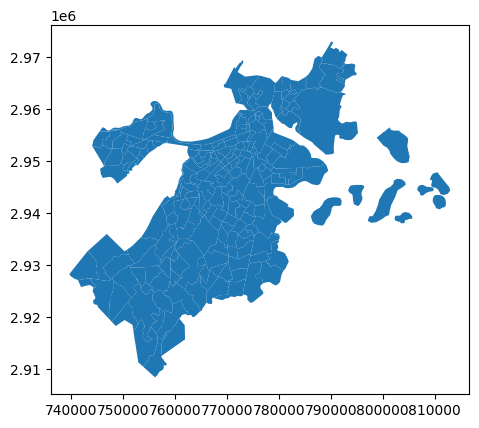

In [12]:
gdf.plot()

In [13]:
merged_df = gdf.merge(census_data.iloc[1:, :], left_on='geoid20', right_on='GEOCODE')
merged_df.head()
merged_df.columns

Index(['geoid20', 'countyfp20', 'namelsad20', 'statefp20', 'tractce20',
       'intptlat20', 'name20', 'funcstat20', 'intptlon20', 'mtfcc20',
       'aland20', 'awater20', 'objectid', 'geometry', 'GEOCODE', 'TRACT',
       'P0020001', 'P0020005', 'P0020006', 'P0020002', 'P0020008', 'P0020007',
       'P0020009', 'P0020010', 'P0020011', 'P0040001', 'P0040005', 'P0040006',
       'P0040002', 'P0040008', 'P0040007', 'P0040009', 'P0040010', 'P0040011',
       'P0050001', 'P0050002', 'P0050003', 'P0050004', 'P0050005', 'P0050006',
       'P0050007', 'P0050008', 'P0050009', 'P0050010', 'H0010001', 'H0010002',
       'H0010003'],
      dtype='object')

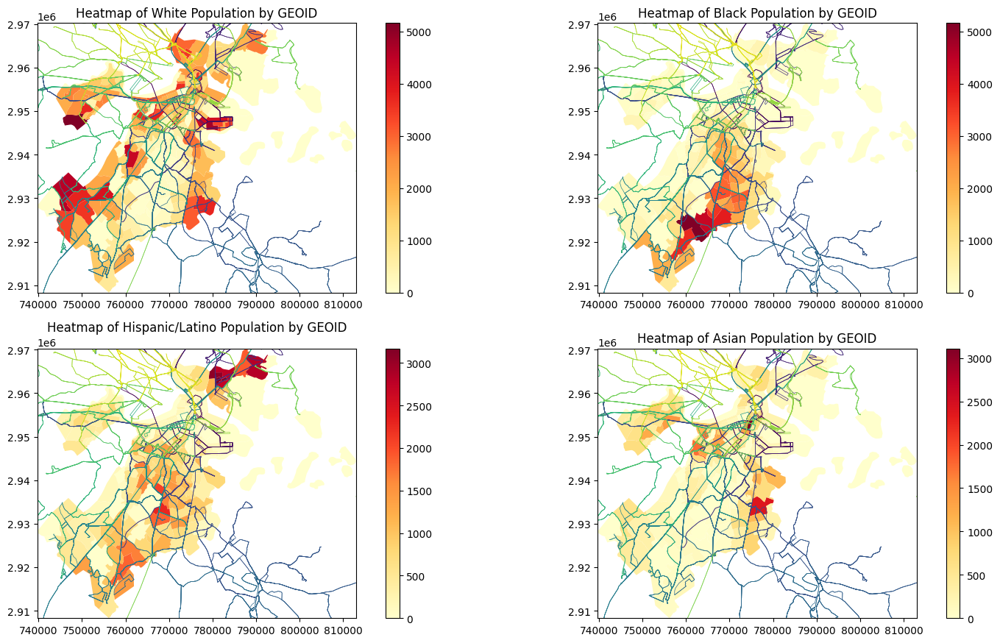

In [14]:
# Load shapefile to GeoDataframe
gdf2 = gpd.read_file('/content/drive/MyDrive/Colab Notebooks/MBTA_Systemwide_GTFS_Map/MBTA_Systemwide_GTFS_Map.shp')

# Create a subplot with shape (2, 2)
fig, axs = plt.subplots(2, 2, figsize=(16, 9))

# Define bounds because shapefile for bus routes exceeds past Boston
x_min, y_min, x_max, y_max = merged_df.total_bounds

for i in range(2):
    for j in range(2):
        ax = axs[i, j]
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)

# Census Code for White, Black, Hispanic / Latino, Asian (in order)
columns_to_numeric = ['P0020005', 'P0020006', 'P0020002', 'P0020008']
for col, ax in zip(columns_to_numeric, axs.flat):
    merged_df[col] = pd.to_numeric(merged_df[col], errors='coerce')
    merged_df.plot(column=col, cmap='YlOrRd', legend=True, ax=ax)

# Create a color map for each bus route and replace original 'route_colo' value
# The original author made a spelling mistake so its called 'route_colo', not 'route_color'

unique_route_ids = gdf2['route_id'].unique()
color_mapping = {route_id: plt.cm.viridis(i / len(unique_route_ids)) for i, route_id in enumerate(unique_route_ids)}
gdf2['route_colo'] = gdf2['route_id'].map(color_mapping)

for i in range(2):
    for j in range(2):
        ax = axs[i, j]
        gdf2.to_crs(merged_df.crs).plot(ax=ax, linewidth=0.5, color=gdf2['route_colo'])

titles = ["White Population", "Black Population", "Hispanic/Latino Population", "Asian Population"]
for i, ax in enumerate(axs.flat):
    ax.set_title(f"Heatmap of {titles[i]} by GEOID")

plt.tight_layout()
plt.show()

In [ ]:
# https://data.boston.gov/dataset/boston-neighborhood-boundaries-approximated-by-2020-census-tracts

In [ ]:
gdf2[gdf2['route_id'] == '4'].head()

,OBJECTID,shape_id,route_id,route_shor,route_long,route_desc,route_type,route_url,route_colo,route_fare,line_id,listed_rou,route_ty_1,created_us,created_da,last_edite,last_edi_1,ShapeSTLen,geometry
2,66656,040070,4,4,North Station - Tide Street,Commuter Bus,3,https://www.mbta.com/schedules/4,"(0.26851, 0.009605, 0.335427, 1.0)",Local Bus,line-4,None,Bus,DOT_ADMIN,2023-05-30,DOT_ADMIN,2023-05-30,5186.243369,"LINESTRING (-71.06004 42.36609, -71.06022 42.3..."
3,66657,040071,4,4,North Station - Tide Street,Commuter Bus,3,https://www.mbta.com/schedules/4,"(0.26851, 0.009605, 0.335427, 1.0)",Local Bus,line-4,None,Bus,DOT_ADMIN,2023-05-30,DOT_ADMIN,2023-05-30,4314.240826,"LINESTRING (-71.03906 42.34435, -71.04034 42.3..."
4,66658,040072,4,4,North Station - Tide Street,Commuter Bus,3,https://www.mbta.com/schedules/4,"(0.26851, 0.009605, 0.335427, 1.0)",Local Bus,line-4,None,Bus,DOT_ADMIN,2023-05-30,DOT_ADMIN,2023-05-30,5031.592156,"LINESTRING (-71.06227 42.36470, -71.06241 42.3..."
5,66659,040073,4,4,North Station - Tide Street,Commuter Bus,3,https://www.mbta.com/schedules/4,"(0.26851, 0.009605, 0.335427, 1.0)",Local Bus,line-4,None,Bus,DOT_ADMIN,2023-05-30,DOT_ADMIN,2023-05-30,4451.345514,"LINESTRING (-71.03448 42.34467, -71.03434 42.3..."


In [ ]:
map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=11)

def rgba_to_hex(rgba):
    r, g, b, _ = rgba  # Extract the Red, Green, and Blue components
    r = int(r * 255)  # Convert to 0-255 range
    g = int(g * 255)
    b = int(b * 255)

    return "#{:02X}{:02X}{:02X}".format(r, g, b)

def style_function(feature):
  properties = feature['properties']
  rgba_color = properties['route_colo']
  color = rgba_to_hex(rgba_color)
  return {
      'color': color,  # Set the line color
      'weight': 3  # Adjust the line thickness (weight)
  }

geojson_data = gdf2[gdf2['route_id'] == '4'].to_json()
folium.GeoJson(geojson_data, style_function=style_function).add_to(map)
map

In [28]:
route_data = pd.read_csv('/content/drive/MyDrive/mean_output.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Colab Notebooks/MBTA_Systemwide_GTFS_Map/MBTA_Systemwide_GTFS_Map.shp')
# route_data.head()
# gdf2.head()
# gdf2 = gdf2.merge(route_data, on='route_id')
# gdf2.head()
gdf.head()
route_data.head()

,route_id,direction_id,end_to_end_travel_time
0,01,Inbound,30.473510
1,01,Outbound,30.899495
2,04,Inbound,25.630918
3,04,Outbound,18.729442
4,07,Inbound,14.421404


# TODO

**Ask if the mean_output can be changed to median_output, because routes extend a long way, its likely that bus routes are more congested as it gets closer to downtown Boston. Not sure, might have to discuss this with team.**

In [82]:
def map_color(travel_time):
    # Define the color gradient (you can adjust this to your preference)
    min_color = (0, 255, 0)  # Green for low travel times
    max_color = (255, 0, 0)  # Red for high travel times

    # Map the travel time to a color within the gradient
    normalized_travel_time = (travel_time - route_data['end_to_end_travel_time'].min()) / (route_data['end_to_end_travel_time'].max() - route_data['end_to_end_travel_time'].min())
    color = tuple(int(min_c + (max_c - min_c) * normalized_travel_time) for min_c, max_c in zip(min_color, max_color))

    # Return the color as a hexadecimal string
    return "#{:02X}{:02X}{:02X}".format(*color)

def style_function(feature):
    end_to_end_travel_time = feature['properties']['end_to_end_travel_time']
    color = map_color(end_to_end_travel_time)

    return {
        'color': color,
        'weight': 3
    }

map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=11)
geojson_data = gdf2.to_json()
folium.GeoJson(geojson_data, style_function=style_function).add_to(map)
map

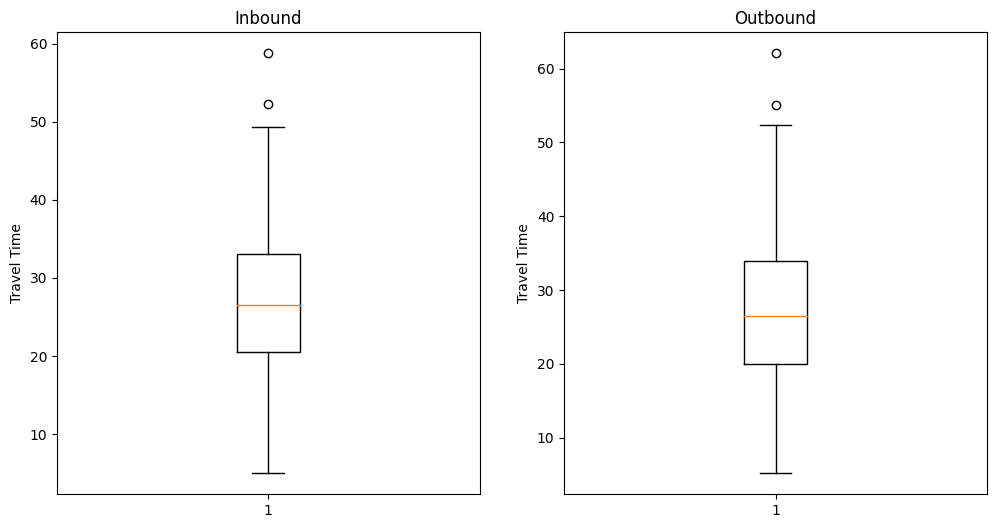

In [23]:
inbound_df = route_data[route_data['direction_id'] == 'Inbound']
outbound_df = route_data[route_data['direction_id'] == 'Outbound']

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

axes[0].boxplot(inbound_df['end_to_end_travel_time'])
axes[0].set_title('Inbound')
axes[0].set_ylabel('Travel Time')

axes[1].boxplot(outbound_df['end_to_end_travel_time'])
axes[1].set_title('Outbound')
axes[1].set_ylabel('Travel Time')

plt.show()

In [30]:
inbound_gdf = gdf.merge(inbound_df, on='route_id')
outbound_gdf = gdf.merge(outbound_df, on='route_id')

In [33]:
def map_color(travel_time):
    # Define the color gradient (you can adjust this to your preference)
    min_color = (0, 255, 0)  # Green for low travel times
    max_color = (255, 0, 0)  # Red for high travel times

    # Map the travel time to a color within the gradient
    normalized_travel_time = (travel_time - inbound_df['end_to_end_travel_time'].min()) / (inbound_df['end_to_end_travel_time'].max() - inbound_df['end_to_end_travel_time'].min())
    color = tuple(int(min_c + (max_c - min_c) * normalized_travel_time) for min_c, max_c in zip(min_color, max_color))

    # Return the color as a hexadecimal string
    return "#{:02X}{:02X}{:02X}".format(*color)

def style_function(feature):
    end_to_end_travel_time = feature['properties']['end_to_end_travel_time']
    color = map_color(end_to_end_travel_time)

    return {
        'color': color,
        'weight': 3
    }

map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=11)
inbound_geojson_data = inbound_gdf.to_json()
folium.GeoJson(inbound_geojson_data, style_function=style_function).add_to(map)
map

In [34]:
def map_color(travel_time):
    # Define the color gradient (you can adjust this to your preference)
    min_color = (0, 255, 0)  # Green for low travel times
    max_color = (255, 0, 0)  # Red for high travel times

    # Map the travel time to a color within the gradient
    normalized_travel_time = (travel_time - outbound_df['end_to_end_travel_time'].min()) / (outbound_df['end_to_end_travel_time'].max() - outbound_df['end_to_end_travel_time'].min())
    color = tuple(int(min_c + (max_c - min_c) * normalized_travel_time) for min_c, max_c in zip(min_color, max_color))

    # Return the color as a hexadecimal string
    return "#{:02X}{:02X}{:02X}".format(*color)

def style_function(feature):
    end_to_end_travel_time = feature['properties']['end_to_end_travel_time']
    color = map_color(end_to_end_travel_time)

    return {
        'color': color,
        'weight': 3
    }

map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=11)
outbound_geojson_data = outbound_gdf.to_json()
folium.GeoJson(outbound_geojson_data, style_function=style_function).add_to(map)
map